IMPORTING THE NECESSARY LIBRARIES

In [1]:
import pandas as pd
import numpy as np
from sklearn.pipeline import Pipeline
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import plotly.express as px 
import matplotlib.pyplot as plt
from yellowbrick.target import FeatureCorrelation
from sklearn.decomposition import PCA


READING THE DATA

In [2]:
df=pd.read_csv("data.csv")
genre=pd.read_csv("data_by_genres.csv")
yearly=pd.read_csv("data_by_year.csv")
artist_data=pd.read_csv("data_by_artist.csv")

DATA PREPROCESSING
      
      

converting the  data type of Release date column  and year from object to date and time and setting a deafult month and date


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [4]:
genre.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


In [5]:
artist_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28680 entries, 0 to 28679
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              28680 non-null  int64  
 1   count             28680 non-null  int64  
 2   acousticness      28680 non-null  float64
 3   artists           28680 non-null  object 
 4   danceability      28680 non-null  float64
 5   duration_ms       28680 non-null  float64
 6   energy            28680 non-null  float64
 7   instrumentalness  28680 non-null  float64
 8   liveness          28680 non-null  float64
 9   loudness          28680 non-null  float64
 10  speechiness       28680 non-null  float64
 11  tempo             28680 non-null  float64
 12  valence           28680 non-null  float64
 13  popularity        28680 non-null  float64
 14  key               28680 non-null  int64  
dtypes: float64(11), int64(3), object(1)
memory usage: 3.3+ MB


In [6]:
yearly.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


In [7]:
df['release_date']

0               1921
1               1921
2               1921
3               1921
4               1921
             ...    
170648    2020-05-29
170649    2020-10-23
170650    2020-11-03
170651    2020-01-17
170652    2020-10-16
Name: release_date, Length: 170653, dtype: object

In [8]:
df['release_date'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 170653 entries, 0 to 170652
Series name: release_date
Non-Null Count   Dtype 
--------------   ----- 
170653 non-null  object
dtypes: object(1)
memory usage: 1.3+ MB


In [9]:
df['release_date'] = pd.to_datetime(df['release_date'],errors='coerce')
mask= df['release_date'].dt.month.isna()
default_date = pd.to_datetime('2022-01-01')
df.loc[mask, 'release_date'] = default_date

In [10]:
df['release_date'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 170653 entries, 0 to 170652
Series name: release_date
Non-Null Count   Dtype         
--------------   -----         
170653 non-null  datetime64[ns]
dtypes: datetime64[ns](1)
memory usage: 1.3 MB


In [11]:
df['release_date']

0        1921-01-01
1        1921-01-01
2        1921-01-01
3        1921-01-01
4        1921-01-01
            ...    
170648   2022-01-01
170649   2022-01-01
170650   2022-01-01
170651   2022-01-01
170652   2022-01-01
Name: release_date, Length: 170653, dtype: datetime64[ns]

In [12]:
df['year'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 170653 entries, 0 to 170652
Series name: year
Non-Null Count   Dtype
--------------   -----
170653 non-null  int64
dtypes: int64(1)
memory usage: 1.3 MB


In [13]:
df['year'] = pd.to_datetime(df['release_date'],errors='coerce')

In [14]:
df['year'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 170653 entries, 0 to 170652
Series name: year
Non-Null Count   Dtype         
--------------   -----         
170653 non-null  datetime64[ns]
dtypes: datetime64[ns](1)
memory usage: 1.3 MB


UNDERSTANDING THE DATA BY VISUALIZATION AND EDA

Music Features over the years

In [15]:
Music_features_1= ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig_1= px.line(yearly, x='year', y=Music_features_1)
fig_1.show()

In [16]:
Music_features_2= ['loudness', 'speechiness']
fig_2= px.line(yearly, x='year', y=Music_features_2)
fig_2.show()

In [17]:
Music_features_2= ['duration_ms']
fig_3= px.line(yearly, x='year', y=Music_features_2)
fig_3.show()

Characterstics of top 15 genres

In [18]:
top_15= genre.nlargest(15, 'popularity')

fig_4= px.bar(top_15, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig_4.show()

Top 10 artists and their song count

In [19]:
artist_data=artist_data.sort_values(by='count',ascending=False)
fig_5= px.bar(artist_data.head(10), x='artists', y='count', 
             title='Top 10 Artists by Number of Songs',
             labels={'number_of_songs': 'Number of Songs', 'artist': 'Artist'})
fig_5.update_layout(xaxis_tickangle=-45)  
fig_5.show()

Conducting correlation analysis by taking popularity as the target variable

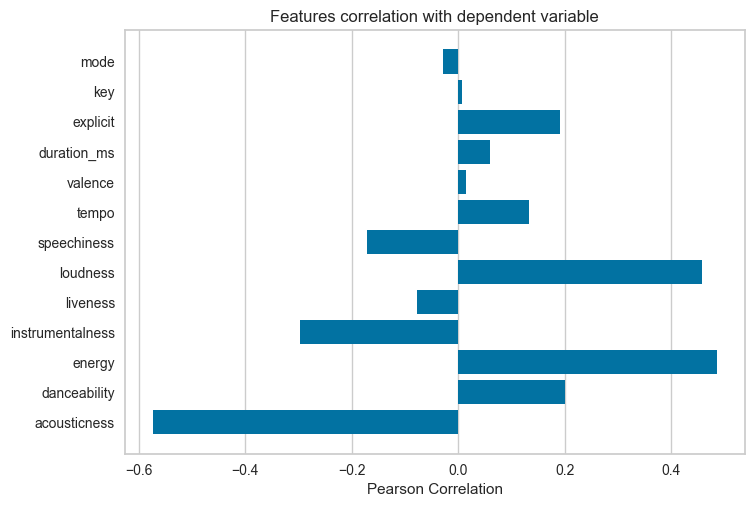

<Axes: title={'center': 'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [20]:

features = np.array(['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode'])
x, y = df[features], df['popularity']
visualizer = FeatureCorrelation(labels=features)
visualizer.fit(x, y)    
visualizer.show()


Clustering with means


here we are applying K-Means algorithm to categorize the songs into 20 clusters based on the numerical audio features.

In [21]:
cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20,random_state=42,init='k-means++',
                                   verbose=False))
                                 ], verbose=False)

z = df.select_dtypes(np.number)
number_cols = list(z.columns)
cluster_pipeline.fit(z)
cluster_labels = cluster_pipeline.predict(z)
df['cluster_label'] = cluster_labels


Visualizing the clusters

In [22]:
pca= Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
embedding = pca.fit_transform(z)
projection = pd.DataFrame(columns=['x', 'y'], data=embedding)
projection['title'] = df['name']
projection['cluster'] = df['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

Song Recommendation

In [23]:
def recommend_nearest_songs(song_name, num_recommendations=10):
    target_song=df[df['name']==song_name].iloc[0]
    target_song= target_song[target_song.apply(lambda x: pd.api.types.is_numeric_dtype(x))]
    target_cluster=target_song['cluster_label']
    cluster_songs = df[df['cluster_label'] == target_cluster]
    cluster_songs = cluster_songs[cluster_songs['name'] != song_name]
    cluster_data = cluster_songs.select_dtypes(include=[np.number])
    target_data= pd.to_numeric(target_song, errors='coerce')
    target_data = target_data.values
    distances = np.linalg.norm(cluster_data - target_data, axis=1)
    cluster_songs['distance'] = distances
    cluster_songs = cluster_songs.sort_values(by='distance')
    #print(cluster_songs['distance'])
    recommendations = cluster_songs.head(num_recommendations)
    recommendations_dict = []
    for idx, row in recommendations.iterrows():
        song_dict = {
            'name': row['name'],
            'year': row['release_date'].year,
            'artists': row['artists']
            }
        recommendations_dict.append(song_dict)
    return recommendations_dict


        

Displaying the Recommendations

In [24]:
song_name = 'Stress'
recommendations = recommend_nearest_songs(song_name)
print("Recommendations for:", song_name)
print(recommendations)

Recommendations for: Stress
[{'name': 'Brand Name', 'year': 2022, 'artists': "['Mac Miller']"}, {'name': 'Song Cry', 'year': 2022, 'artists': "['JAY-Z']"}, {'name': 'Song Cry', 'year': 2022, 'artists': "['JAY-Z']"}, {'name': 'Blessings - Extended Version', 'year': 2022, 'artists': "['Big Sean', 'Drake', 'Kanye West']"}, {'name': "Look What You've Done", 'year': 2022, 'artists': "['Drake']"}, {'name': 'Thirsty', 'year': 2022, 'artists': "['PARTYNEXTDOOR']"}, {'name': 'Fight the Feeling', 'year': 2022, 'artists': "['Mac Miller', 'Kendrick Lamar', 'Iman Omari']"}, {'name': 'Players Holiday', 'year': 2022, 'artists': "['Ant Banks', 'Mac Mall', 'Too $hort']"}, {'name': 'Throes of Rejection', 'year': 1994, 'artists': "['Pantera']"}, {'name': 'King Of The Fall', 'year': 2022, 'artists': "['The Weeknd']"}]
